Settings for matplotlib:

In [5]:
%matplotlib inline
# %matplotlib notebook
%config InlineBackend.figure_format = 'retina'

## 3D Plotting Example with Plotly

In [2]:
import pymagnet as pm
pm.reset_magnets() # clear magnet registry

center = (0, 0, 0)    
radius = 5e-3    
length = 20e-3

# Create a magnet instance
m_cyl = pm.magnets.Cylinder(radius = radius, length = length, Jr = 1.0,
                            center=center,
                            alpha = 0, # rotation of magnet w.r.t. z-axis
                            beta = -30, # rotation of magnet w.r.t. y-axis
                            gamma = 0, # rotation of magnet w.r.t. x-axis
                            )

# Calculate and display 3 slices
# Cache is a dictionary containing all the calculated values
cache = pm.plots.surface_slice3(cmin=0.0, # minimum field value
                                cmax=0.3, # maximum field value
                                opacity=1.0, # opacity of slices
                                num_arrows=10, # number of arrows in vector field
                                cone_opacity=0.9, # opacity of arrows
                                )


# Calculate and display volume plot
# volume_cache is a dictionary containing all the calculated values
volume_cache = pm.plots.volume_plot(cmin=0.0, # minimum field value
                                    cmax=0.3, # maximum field value
                                    opacity=0.1, # needs to be small for visibility
                                    num_levels=6, # number of color levels to be plotted
                                    # number of points in each direction, total number is num_points^3
                                    num_points=50,
                                    )


## 2D Plotting Example with Matplotlib

### Circle

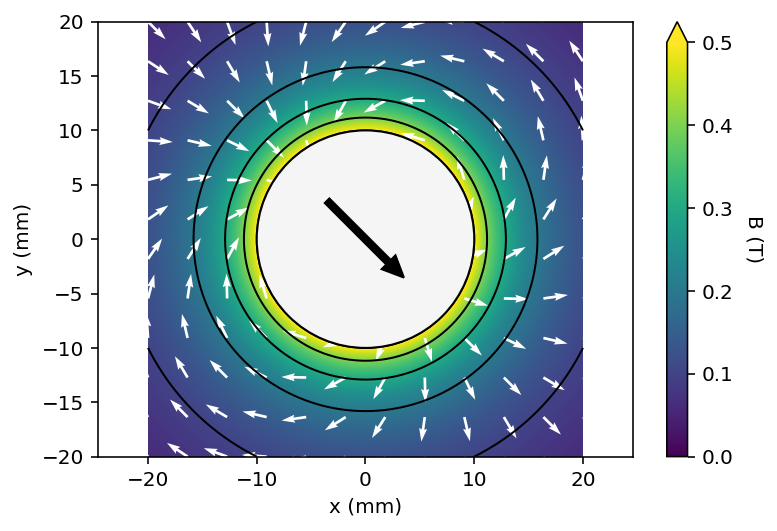

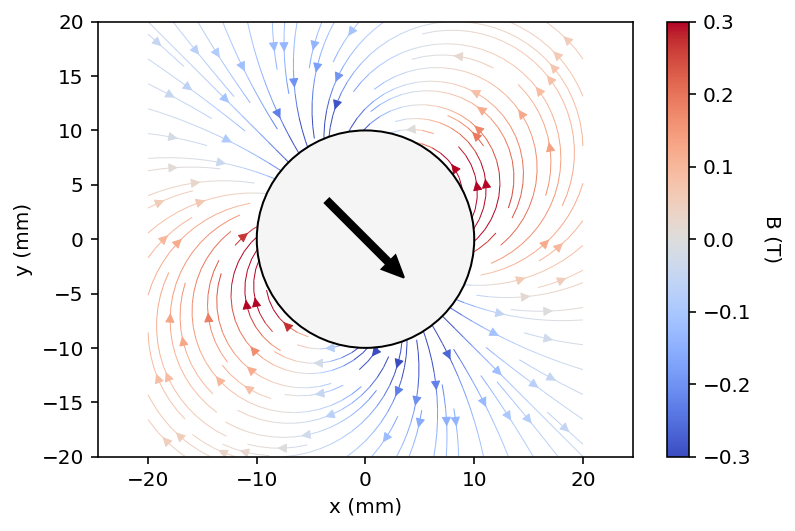

In [3]:
import pymagnet as pm

pm.reset_magnets() # clear magnet registry

cmap = 'viridis' # set the colormap

radius = 10e-3
center = (0, 0)

# Create magnet
_ = pm.magnets.Circle(radius=radius, Jr = 1.0, center=center, alpha=45)


# Prepare 100x100 grid of x,y coordinates to calculate the field
x, y = pm.grid2D(2*radius, 2*radius)

# Calculate the magnetic field due to all magnets in the registry
B = pm.B_calc_2D(x, y)

# Plot the result, vector_plot = True toggles on the vector field plot
pm.plots.plot_2D_contour(x, y, B,
                         cmax=0.5,
                         num_levels=6,
                         cmap=cmap,
                         vector_plot=True,
                         vector_arrows=11)



# Plot the result as a streamplot 
pm.plots.plot_2D_contour(x, y, B,
                         cmin = -0.3,
                         cmax=0.3,
                         cmap='coolwarm',
                         plot_type="streamplot",
                         stream_color= 'vertical', # 'vertical', 'horizontal', 'normal':
#                          corresponds to coloring by B.x, B.y, B.n
                        )

### Rectangles

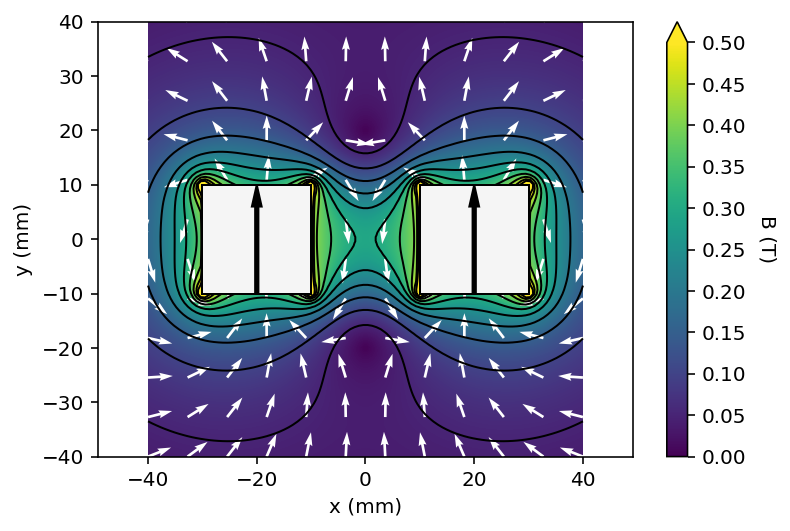

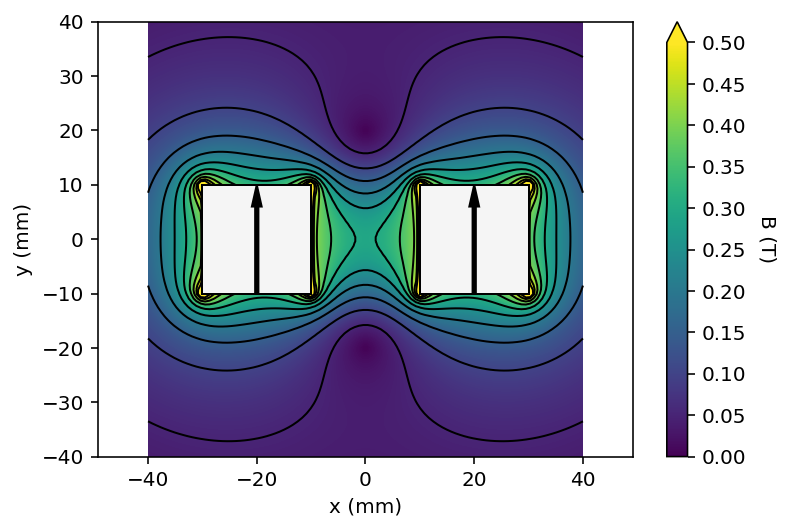

In [4]:
import pymagnet as pm
pm.reset_magnets() # clear magnet registry

cmap = 'viridis' # set the colormap

width = 20e-3
height = 20e-3

# Set the space between magnets to be the width of one
half_gap = width / 2 

# Center of first magnet
center = (-width / 2 - half_gap, 0)

# Create first magnet
_ = pm.magnets.Rectangle(width=width, height=height,
                        Jr=1.0, center=center, theta=0.0)

# Centre of second magnet
center = (width / 2 + half_gap, 0)

# Create second magnet
_ = pm.magnets.Rectangle(width=width, height=height,
                        Jr=1.0, center=center, theta=90.0)

# Prepare 100x100 grid of x,y coordinates to calculate the field
x, y = pm.grid2D(2 * width, 2 * height)

# Calculate the magnetic field due to all magnets in the registry
B = pm.B_calc_2D(x, y)

# Plot the result, vector_plot = True toggles on the vector field plot
pm.plots.plot_2D_contour(x, y, B, cmin=0.0, # minimum field value
                                 cmax=0.5, # maximum field value
                                 vector_plot=True, # plot the vector field
                                 cmap=cmap, # set the colormap
                                 )

pm.plots.plot_2D_contour(x, y, B, cmin=0.0, # minimum field value
                                 cmax=0.5, # maximum field value
                                 vector_plot=False, # plot the vector field
                                 cmap=cmap, # set the colormap
                                 )
